In [2]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import json

# Datos Códigos Departamentos

In [3]:
df_departamentos_codigos = pd.read_csv('../../Data/Departamentos_Codigos.csv')

In [4]:
df_departamentos_codigos.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33 entries, 0 to 32
Data columns (total 10 columns):
 #   Column                               Non-Null Count  Dtype 
---  ------                               --------------  ----- 
 0   Codigo                               33 non-null     int64 
 1   Departamento_DANE                    33 non-null     object
 2   Departamento_DIVIPOLA                33 non-null     object
 3   Departamento_REPS                    33 non-null     object
 4   Departamento_IPS_Complejidad         33 non-null     object
 5   Departamento_IPS_Atencion_Capacidad  33 non-null     object
 6   Departamento_Capacidad_Instalada     33 non-null     object
 7   Departamento_Radiografia             33 non-null     object
 8   Departamento_Caracterizacion         33 non-null     object
 9   Departamento                         33 non-null     object
dtypes: int64(1), object(9)
memory usage: 2.7+ KB


In [5]:
df_departamentos_codigos.head()

,Codigo,Departamento_DANE,Departamento_DIVIPOLA,Departamento_REPS,Departamento_IPS_Complejidad,Departamento_IPS_Atencion_Capacidad,Departamento_Capacidad_Instalada,Departamento_Radiografia,Departamento_Caracterizacion,Departamento
0,5,Antioquia,ANTIOQUIA,Antioquia,Antioquia,Antioquia,Antioquia,Antioquia,Antioquia,Antioquia
1,8,Atlántico,ATLÁNTICO,AtlÃ¡ntico,AtlÃ¡ntico,AtlÃ¡ntico,AtlÃ¡ntico,Atlántico,Atlántico,Atlántico
2,11,"Bogotá, D.C.","BOGOTÁ, D.C.",BogotÃ¡ D.C,BogotÃ¡ D.C,BogotÃ¡ D.C,"BogotÃ¡, D.C.",Bogotá D.C,Bogotá D.C,Bogotá D.C
3,13,Bolívar,BOLÍVAR,BolÃ­var,BolÃ­var,BolÃ­var,BolÃ­var,Bolívar,Bolívar,Bolívar
4,15,Boyacá,BOYACÁ,BoyacÃ¡,BoyacÃ¡,BoyacÃ¡,BoyacÃ¡,Boyacá,Boyacá,Boyacá


# Datos Códigos Municipios

In [6]:
df_municipios_codigos = pd.read_csv('../../Data/Departamentos_Municipios_Codigos.csv')

In [7]:
df_municipios_codigos.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1121 entries, 0 to 1120
Data columns (total 9 columns):
 #   Column                            Non-Null Count  Dtype 
---  ------                            --------------  ----- 
 0   Codigo_Departamento               1121 non-null   int64 
 1   Departamento                      1121 non-null   object
 2   Codigo_Municipio                  1121 non-null   int64 
 3   Municipio                         1121 non-null   object
 4   Municipio_DIVIPOLA                1121 non-null   object
 5   Municipio_Poblacion               1121 non-null   object
 6   Municipio_REPS                    1121 non-null   object
 7   Municipio_IPS_Complejidad         1121 non-null   object
 8   Municipio_IPS_Atencion_Capacidad  1121 non-null   object
dtypes: int64(2), object(7)
memory usage: 78.9+ KB


In [8]:
df_municipios_codigos.head()

,Codigo_Departamento,Departamento,Codigo_Municipio,Municipio,Municipio_DIVIPOLA,Municipio_Poblacion,Municipio_REPS,Municipio_IPS_Complejidad,Municipio_IPS_Atencion_Capacidad
0,5,ANTIOQUIA,5001,Medellín,MEDELLÍN,Medellín,MEDELLÃN,MEDELLÃN,MEDELLÃN
1,5,ANTIOQUIA,5002,Abejorral,ABEJORRAL,Abejorral,ABEJORRAL,ABEJORRAL,ABEJORRAL
2,5,ANTIOQUIA,5004,Abriaquí,ABRIAQUÍ,Abriaquí,ABRIAQUÃ,ABRIAQUÃ,ABRIAQUÃ
3,5,ANTIOQUIA,5021,Alejandría,ALEJANDRÍA,Alejandría,ALEJANDRÃA,ALEJANDRÃA,ALEJANDRÃA
4,5,ANTIOQUIA,5030,Amagá,AMAGÁ,Amagá,AMAGÃ,AMAGÃ,AMAGÃ


# Datos REPS

In [9]:
df_reps = pd.read_csv('../../Data/REPS.csv')

C:\Users\SGM\AppData\Local\Temp\ipykernel_6896\3122532733.py:1: DtypeWarning: Columns (0,2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_reps = pd.read_csv('../../Data/REPS.csv')


In [10]:
df_reps['codigo_prestador'] = df_reps['CodigoPrestador']
df_reps['codigo_habilitacion_sede'] = df_reps['CodigoHabilitacionSede']
df_reps.iloc[56503]['CodigoPrestador'], df_reps.iloc[56503]['CodigoHabilitacionSede'], df_reps.iloc[74472]['CodigoPrestador'], df_reps.iloc[74472]['CodigoHabilitacionSede']

df_reps.at[56503, 'codigo_prestador'] = df_reps.iloc[56503]['CodigoPrestador'].replace(" ", "")
df_reps.at[56503, 'codigo_habilitacion_sede'] = df_reps.iloc[56503]['CodigoHabilitacionSede'].replace(" ", "")
df_reps.at[74472, 'codigo_prestador'] = df_reps.iloc[74472]['CodigoPrestador'].replace(" ", "")
df_reps.at[74472, 'codigo_habilitacion_sede'] = df_reps.iloc[74472]['CodigoHabilitacionSede'].replace(" ", "")

df_reps['codigo_prestador'] = df_reps['codigo_prestador'].astype(np.int64)
df_reps['codigo_habilitacion_sede'] = df_reps['codigo_habilitacion_sede'].astype(np.int64)

In [11]:
columnas = [
    'DepartamentoSedeDesc',
    'MunicipioPrestadorDesc',
    'MunicipioSede',
    'MunicipioSedeDesc',
    'codigo_prestador',
    'codigo_habilitacion_sede',
    'NaturalezaJuridica',
    'ClasePrestadorDesc'
]

In [12]:
df_reps = df_reps[columnas]

In [13]:
departamentos = [
    'Amazonas', 'Antioquia', 'Arauca', 'Atlántico',
    'Bogotá D.C', 'Bolívar', 'Boyacá', 'Caldas',
    'Caquetá', 'Casanare', 'Cauca', 'Cesar', 
    'Chocó', 'Córdoba', 'Cundinamarca', 'Guainía', 
    'Guaviare', 'Huila', 'La Guajira', 'Magdalena',
    'Meta', 'Nariño', 'Norte de Santander', 'Putumayo',
    'Quindío', 'Risaralda', 'San Andrés y Providencia', 'Santander',
    'Sucre', 'Tolima', 'Valle del cauca', 'Vaupés', 
    'Vichada'
    ]

distritos_especiales = [
    'Barranquilla',
    'Buenaventura',
    'Cartagena',
    'Santa Marta'
]

distritos_especiales_departamentos = {
    'Barranquilla': 'Atlántico',
    'Buenaventura': 'Valle del cauca',
    'Cartagena': 'Bolívar',
    'Santa Marta': 'Magdalena',
    'Cali': 'Valle del cauca'
}

In [14]:
df_reps['Departamento'] = df_reps['DepartamentoSedeDesc'].replace(distritos_especiales_departamentos)

In [15]:
df_reps = df_reps[df_reps['ClasePrestadorDesc'] == 'Instituciones Prestadoras de Servicios de Salud - IPS']

In [16]:
df_reps.info()

<class 'pandas.core.frame.DataFrame'>
Index: 19726 entries, 0 to 76393
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   DepartamentoSedeDesc      19726 non-null  object
 1   MunicipioPrestadorDesc    19726 non-null  object
 2   MunicipioSede             19726 non-null  int64 
 3   MunicipioSedeDesc         19726 non-null  object
 4   codigo_prestador          19726 non-null  int64 
 5   codigo_habilitacion_sede  19726 non-null  int64 
 6   NaturalezaJuridica        19726 non-null  object
 7   ClasePrestadorDesc        19726 non-null  object
 8   Departamento              19726 non-null  object
dtypes: int64(3), object(6)
memory usage: 1.5+ MB


In [17]:
df_reps.head()

,DepartamentoSedeDesc,MunicipioPrestadorDesc,MunicipioSede,MunicipioSedeDesc,codigo_prestador,codigo_habilitacion_sede,NaturalezaJuridica,ClasePrestadorDesc,Departamento
0,Amazonas,LETICIA,91263,EL ENCANTO,9100100019,912630001911,Pública,Instituciones Prestadoras de Servicios de Salu...,Amazonas
1,Amazonas,LETICIA,91405,LA CHORRERA,9100100019,914050001914,Pública,Instituciones Prestadoras de Servicios de Salu...,Amazonas
2,Amazonas,LETICIA,91407,LA PEDRERA,9100100019,914070001915,Pública,Instituciones Prestadoras de Servicios de Salu...,Amazonas
3,Amazonas,LETICIA,91430,LA VICTORIA,9100100019,914300001916,Pública,Instituciones Prestadoras de Servicios de Salu...,Amazonas
5,Amazonas,LETICIA,91001,LETICIA,9100100019,910010001901,Pública,Instituciones Prestadoras de Servicios de Salu...,Amazonas


# IPS por Municipio - 2022

In [18]:
df_reps = pd.merge(df_reps, df_municipios_codigos[['Codigo_Municipio', 'Municipio']], how='inner', left_on='MunicipioSede', right_on='Codigo_Municipio')
df_reps = pd.merge(df_reps, df_departamentos_codigos[['Codigo', 'Departamento']], how='left', left_on='Departamento', right_on='Departamento')
df_reps['Municipio_Departamento'] = df_reps['Municipio'] + " (" + df_reps['Departamento'] + ")"

In [19]:
df_reps.head()

,DepartamentoSedeDesc,MunicipioPrestadorDesc,MunicipioSede,MunicipioSedeDesc,codigo_prestador,codigo_habilitacion_sede,NaturalezaJuridica,ClasePrestadorDesc,Departamento,Codigo_Municipio,Municipio,Codigo,Municipio_Departamento
0,Amazonas,LETICIA,91263,EL ENCANTO,9100100019,912630001911,Pública,Instituciones Prestadoras de Servicios de Salu...,Amazonas,91263,El Encanto,91,El Encanto (Amazonas)
1,Amazonas,LETICIA,91405,LA CHORRERA,9100100019,914050001914,Pública,Instituciones Prestadoras de Servicios de Salu...,Amazonas,91405,La Chorrera,91,La Chorrera (Amazonas)
2,Amazonas,LETICIA,91407,LA PEDRERA,9100100019,914070001915,Pública,Instituciones Prestadoras de Servicios de Salu...,Amazonas,91407,La Pedrera,91,La Pedrera (Amazonas)
3,Amazonas,LETICIA,91430,LA VICTORIA,9100100019,914300001916,Pública,Instituciones Prestadoras de Servicios de Salu...,Amazonas,91430,La Victoria,91,La Victoria (Amazonas)
4,Amazonas,LETICIA,91001,LETICIA,9100100019,910010001901,Pública,Instituciones Prestadoras de Servicios de Salu...,Amazonas,91001,Leticia,91,Leticia (Amazonas)


In [20]:
df_num_reps = df_reps.groupby('Municipio_Departamento').agg(IPS_2022=('codigo_habilitacion_sede', 'count')).reset_index().sort_values('IPS_2022', ascending=True).reset_index(drop=True)

In [21]:
df_num_reps

,Municipio_Departamento,IPS_2022
0,Firavitoba (Boyacá),1
1,Saboyá (Boyacá),1
2,Solita (Caquetá),1
3,El Castillo (Meta),1
4,Somondoco (Boyacá),1
...,...,...
1111,Cartagena de Indias (Bolívar),604
1112,Barranquilla (Atlántico),817
1113,Cali (Valle del cauca),1064
1114,Medellín (Antioquia),1167


In [22]:
top_bars = 30
fig = px.bar(data_frame=df_num_reps.iloc[-top_bars:], 
             x='IPS_2022', 
             y='Municipio_Departamento', 
             orientation='h')

fig.update_xaxes(title_text='Número de IPS')
fig.update_xaxes(range=[0,3200])
fig.update_yaxes(title_text='Municipio')
fig.update_layout(title='Número de IPS por Municipio - 2022')

color_sequence = ['#3364C7' for i in df_num_reps['Municipio_Departamento']]
fig.update_traces(marker=dict(color=color_sequence))

fig.update_traces(text=df_num_reps['IPS_2022'].iloc[-top_bars:], textposition='outside')

# fig.update_layout(plot_bgcolor='rgba(0,0,0,0)')

fig.update_layout(width=800, height=700)

fig.show()

In [23]:
top_bars = 30
fig = px.bar(data_frame=df_num_reps.iloc[:top_bars], 
             x='IPS_2022', 
             y='Municipio_Departamento', 
             orientation='h')

fig.update_xaxes(title_text='Número de IPS')
# fig.update_xaxes(range=[0,3100])
fig.update_yaxes(title_text='Municipio')
fig.update_layout(title='Número de IPS por Municipio - 2022')

color_sequence = ['#3364C7' for i in df_num_reps['Municipio_Departamento']]
fig.update_traces(marker=dict(color=color_sequence))

fig.update_traces(text=df_num_reps['IPS_2022'].iloc[:top_bars], textposition='outside')

# fig.update_layout(plot_bgcolor='rgba(0,0,0,0)')

fig.update_layout(width=800, height=700)

fig.show()

# Poblacion - 2022

In [24]:
df_poblacion_2022 = pd.read_csv('../../Data/Poblacion_Municipio_2020_2035.csv')

In [25]:
df_poblacion_2022.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53856 entries, 0 to 53855
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   DP               53856 non-null  int64 
 1   DPNOM            53856 non-null  object
 2   MPIO             53856 non-null  int64 
 3   DPMP             53856 non-null  object
 4   AÑO              53856 non-null  int64 
 5   ÁREA GEOGRÁFICA  53856 non-null  object
 6   Población        53856 non-null  int64 
dtypes: int64(4), object(3)
memory usage: 2.9+ MB


In [26]:
df_poblacion_2022.head()

,DP,DPNOM,MPIO,DPMP,AÑO,ÁREA GEOGRÁFICA,Población
0,5,Antioquia,5001,Medellín,2020,Cabecera Municipal,2476569
1,5,Antioquia,5001,Medellín,2020,Centros Poblados y Rural Disperso,43023
2,5,Antioquia,5001,Medellín,2020,Total,2519592
3,5,Antioquia,5001,Medellín,2021,Cabecera Municipal,2506656
4,5,Antioquia,5001,Medellín,2021,Centros Poblados y Rural Disperso,42352


In [27]:
df_poblacion_2022 = df_poblacion_2022[(df_poblacion_2022['AÑO'] == 2022) & (df_poblacion_2022['ÁREA GEOGRÁFICA'] == 'Total')].reset_index(drop=True).drop(['AÑO', 'ÁREA GEOGRÁFICA'], axis=1).sort_values('Población').reset_index(drop=True)
df_poblacion_2022 = pd.merge(df_poblacion_2022, df_municipios_codigos[['Codigo_Municipio', 'Municipio']], how='inner', left_on='MPIO', right_on='Codigo_Municipio')
df_poblacion_2022 = pd.merge(df_poblacion_2022, df_departamentos_codigos[['Codigo', 'Departamento']], how='inner', left_on='DP', right_on='Codigo')
df_poblacion_2022['Municipio_Departamento'] = df_poblacion_2022['Municipio'] + " (" + df_poblacion_2022['Departamento'] + ")"

df_poblacion_2022

,DP,DPNOM,MPIO,DPMP,Población,Codigo_Municipio,Municipio,Codigo,Departamento,Municipio_Departamento
0,94,Guainía,94885,La Guadalupe (ANM),310,94885,La Guadalupe,94,Guainía,La Guadalupe (Guainía)
1,94,Guainía,94886,Cacahual (ANM),969,94886,Cacahual,94,Guainía,Cacahual (Guainía)
2,94,Guainía,94888,Morichal (ANM),985,94888,Morichal,94,Guainía,Morichal (Guainía)
3,94,Guainía,94883,San Felipe (ANM),1913,94883,San Felipe,94,Guainía,San Felipe (Guainía)
4,94,Guainía,94884,Puerto Colombia (ANM),2111,94884,Puerto Colombia,94,Guainía,Puerto Colombia (Guainía)
...,...,...,...,...,...,...,...,...,...,...
1116,23,Córdoba,23162,Cereté,112124,23162,Cereté,23,Córdoba,Cereté (Córdoba)
1117,23,Córdoba,23660,Sahagún,114033,23660,Sahagún,23,Córdoba,Sahagún (Córdoba)
1118,23,Córdoba,23417,Lorica,116772,23417,Lorica,23,Córdoba,Lorica (Córdoba)
1119,23,Córdoba,23001,Montería,518608,23001,Montería,23,Córdoba,Montería (Córdoba)


# IPS por Habitantes - 2022

In [28]:
df_ips_por_habitantes = pd.merge(df_num_reps, df_poblacion_2022, how='right', on='Municipio_Departamento')
df_ips_por_habitantes.fillna(0, inplace=True)
df_ips_por_habitantes['IPS/Habitantes'] = (df_ips_por_habitantes['IPS_2022'] / df_ips_por_habitantes['Población'] * 1e5).round(0)
df_ips_por_habitantes = df_ips_por_habitantes.sort_values('IPS/Habitantes', ascending=True).reset_index(drop=True)

In [29]:
df_ips_por_habitantes

,Municipio_Departamento,IPS_2022,DP,DPNOM,MPIO,DPMP,Población,Codigo_Municipio,Municipio,Codigo,Departamento,IPS/Habitantes
0,La Guadalupe (Guainía),0.0,94,Guainía,94885,La Guadalupe (ANM),310,94885,La Guadalupe,94,Guainía,0.0
1,Cacahual (Guainía),0.0,94,Guainía,94886,Cacahual (ANM),969,94886,Cacahual,94,Guainía,0.0
2,Morichal (Guainía),0.0,94,Guainía,94888,Morichal (ANM),985,94888,Morichal,94,Guainía,0.0
3,Puerto Colombia (Guainía),0.0,94,Guainía,94884,Puerto Colombia (ANM),2111,94884,Puerto Colombia,94,Guainía,0.0
4,Pana Pana (Guainía),0.0,94,Guainía,94887,Pana Pana (ANM),2210,94887,Pana Pana,94,Guainía,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
1116,Carurú (Vaupés),5.0,97,Vaupés,97161,Carurú,3408,97161,Carurú,97,Vaupés,147.0
1117,La Victoria (Amazonas),1.0,91,Amazonas,91430,La Victoria (ANM),668,91430,La Victoria,91,Amazonas,150.0
1118,Taraira (Vaupés),4.0,97,Vaupés,97666,Taraira,2481,97666,Taraira,97,Vaupés,161.0
1119,Pacoa (Vaupés),10.0,97,Vaupés,97511,Pacoa (ANM),4573,97511,Pacoa,97,Vaupés,219.0


In [30]:
# df_ips_por_habitantes.to_csv('../../Data/Test/ips_por_habitantes.csv')

In [31]:
df_ips_por_habitantes

,Municipio_Departamento,IPS_2022,DP,DPNOM,MPIO,DPMP,Población,Codigo_Municipio,Municipio,Codigo,Departamento,IPS/Habitantes
0,La Guadalupe (Guainía),0.0,94,Guainía,94885,La Guadalupe (ANM),310,94885,La Guadalupe,94,Guainía,0.0
1,Cacahual (Guainía),0.0,94,Guainía,94886,Cacahual (ANM),969,94886,Cacahual,94,Guainía,0.0
2,Morichal (Guainía),0.0,94,Guainía,94888,Morichal (ANM),985,94888,Morichal,94,Guainía,0.0
3,Puerto Colombia (Guainía),0.0,94,Guainía,94884,Puerto Colombia (ANM),2111,94884,Puerto Colombia,94,Guainía,0.0
4,Pana Pana (Guainía),0.0,94,Guainía,94887,Pana Pana (ANM),2210,94887,Pana Pana,94,Guainía,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
1116,Carurú (Vaupés),5.0,97,Vaupés,97161,Carurú,3408,97161,Carurú,97,Vaupés,147.0
1117,La Victoria (Amazonas),1.0,91,Amazonas,91430,La Victoria (ANM),668,91430,La Victoria,91,Amazonas,150.0
1118,Taraira (Vaupés),4.0,97,Vaupés,97666,Taraira,2481,97666,Taraira,97,Vaupés,161.0
1119,Pacoa (Vaupés),10.0,97,Vaupés,97511,Pacoa (ANM),4573,97511,Pacoa,97,Vaupés,219.0


In [32]:
df_ips_por_habitantes['IPS_2022'].sum()

19726.0

In [33]:
top_bars = 30
fig = px.bar(data_frame=df_ips_por_habitantes.iloc[-top_bars:], 
             x='IPS/Habitantes', 
             y='Municipio_Departamento', 
             orientation='h')

fig.update_xaxes(title_text='IPS por cada 100 mil habitantes')
fig.update_xaxes(range=[0,460])
fig.update_yaxes(title_text='Municipio')
fig.update_layout(title='Número de IPS por cada 100 mil habitantes por Municipio - 2022')

color_sequence = ['#3364C7' for i in df_ips_por_habitantes['Municipio']]
fig.update_traces(marker=dict(color=color_sequence))

fig.update_traces(text=df_ips_por_habitantes['IPS/Habitantes'].iloc[-top_bars:], textposition='outside')

# fig.update_layout(plot_bgcolor='rgba(0,0,0,0)')

fig.update_layout(width=800, height=700)

fig.show()

In [34]:
top_bars = 30
fig = px.bar(data_frame=df_ips_por_habitantes.iloc[:top_bars], 
             x='IPS/Habitantes', 
             y='Municipio_Departamento', 
             orientation='h')

fig.update_xaxes(title_text='IPS por cada 100 mil habitantes')
# fig.update_xaxes(range=[0,3100])
fig.update_yaxes(title_text='Municipio')
fig.update_layout(title='Número de IPS por cada 100 mil habitantes por Municipio - 2022')

color_sequence = ['#3364C7' for i in df_ips_por_habitantes['Municipio_Departamento']]
fig.update_traces(marker=dict(color=color_sequence))

fig.update_traces(text=df_ips_por_habitantes['IPS/Habitantes'].iloc[:top_bars], textposition='outside')

# fig.update_layout(plot_bgcolor='rgba(0,0,0,0)')

fig.update_layout(width=800, height=700)

fig.show()

# Mapa - IPS por Habitantes - 2022

In [35]:
file = open('../../Data/Colombia_Municipios_Geo.json')
geojson = json.load(file)
file.close()

In [36]:
cont = 1
for line in geojson['features']:
    if 'id' in line:
        id = line['id']
        line['properties']['id'] = id
    # print(line['properties'])
    # break   
        cont += 1
    
print(cont)
for line in geojson['features']:
    print(line['properties'])


1121
{'dpt': 'LA GUAJIRA', 'name': 'URIBIA', 'id': '44847'}
{'dpt': 'LA GUAJIRA', 'name': 'MANAURE', 'id': '44560'}
{'dpt': 'LA GUAJIRA', 'name': 'MAICAO', 'id': '44430'}
{'dpt': 'LA GUAJIRA', 'name': 'RIOHACHA', 'id': '44001'}
{'dpt': 'LA GUAJIRA', 'name': 'DIBULLA', 'id': '44090'}
{'dpt': 'MAGDALENA', 'name': 'SANTA MARTA', 'id': '47001'}
{'dpt': 'LA GUAJIRA', 'name': 'HATONUEVO', 'id': '44378'}
{'dpt': 'LA GUAJIRA', 'name': 'BARRANCAS', 'id': '44078'}
{'dpt': 'MAGDALENA', 'name': 'CIENAGA', 'id': '47189'}
{'dpt': 'ATLANTICO', 'name': 'BARRANQUILLA', 'id': '08001'}
{'dpt': 'MAGDALENA', 'name': 'SITIONUEVO', 'id': '47745'}
{'dpt': 'ATLANTICO', 'name': 'PUERTO COLOMBIA', 'id': '08573'}
{'dpt': 'LA GUAJIRA', 'name': 'DISTRACCION', 'id': '44098'}
{'dpt': 'LA GUAJIRA', 'name': 'FONSECA', 'id': '44279'}
{'dpt': 'LA GUAJIRA', 'name': 'SAN JUAN DEL CESAR', 'id': '44650'}
{'dpt': 'MAGDALENA', 'name': 'PUEBLOVIEJO', 'id': '47570'}
{'dpt': 'ATLANTICO', 'name': 'TUBARA', 'id': '08832'}
{'dpt': '

In [37]:
departamentos_nombre = []
municipios_codigos = []
municipios_nombres = []
for i in geojson['features']:
    if 'id' in i:
        municipio = i['properties']
        departamento_nombre = municipio['dpt']
        municipio_codigo = i['id']
        municipio_nombre = municipio['name']
        municipios_codigos.append(municipio_codigo)
        municipios_nombres.append(municipio_nombre)
        departamentos_nombre.append(departamento_nombre)

municipios_json = pd.DataFrame(
    {
        'Departamento_Nombre': departamentos_nombre,
        'Codigo_Municipio_Str': municipios_codigos,
        'Nombre_Municipio': municipios_nombres,
    }
)
municipios_json['Codigo_Municipio_Valor'] = municipios_json['Codigo_Municipio_Str'].astype(int)
municipios_json.drop_duplicates(inplace=True)

In [38]:
municipios_json

,Departamento_Nombre,Codigo_Municipio_Str,Nombre_Municipio,Codigo_Municipio_Valor
0,LA GUAJIRA,44847,URIBIA,44847
1,LA GUAJIRA,44560,MANAURE,44560
2,LA GUAJIRA,44430,MAICAO,44430
3,LA GUAJIRA,44001,RIOHACHA,44001
4,LA GUAJIRA,44090,DIBULLA,44090
...,...,...,...,...
1115,ANTIOQUIA,05480,MUTATA,5480
1116,CHOCO,27150,CARMEN DEL DARIEN,27150
1117,ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA...,88001,SAN ANDRES,88001
1118,ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA...,88000,SANTA CATALINA,88000


In [39]:
df_municipios_codigos.head()

,Codigo_Departamento,Departamento,Codigo_Municipio,Municipio,Municipio_DIVIPOLA,Municipio_Poblacion,Municipio_REPS,Municipio_IPS_Complejidad,Municipio_IPS_Atencion_Capacidad
0,5,ANTIOQUIA,5001,Medellín,MEDELLÍN,Medellín,MEDELLÃN,MEDELLÃN,MEDELLÃN
1,5,ANTIOQUIA,5002,Abejorral,ABEJORRAL,Abejorral,ABEJORRAL,ABEJORRAL,ABEJORRAL
2,5,ANTIOQUIA,5004,Abriaquí,ABRIAQUÍ,Abriaquí,ABRIAQUÃ,ABRIAQUÃ,ABRIAQUÃ
3,5,ANTIOQUIA,5021,Alejandría,ALEJANDRÍA,Alejandría,ALEJANDRÃA,ALEJANDRÃA,ALEJANDRÃA
4,5,ANTIOQUIA,5030,Amagá,AMAGÁ,Amagá,AMAGÃ,AMAGÃ,AMAGÃ


In [40]:
municipios_json = pd.merge(municipios_json, df_municipios_codigos[['Codigo_Municipio', 'Municipio', 'Codigo_Departamento']], how='inner', left_on='Codigo_Municipio_Valor', right_on='Codigo_Municipio')

In [41]:
municipios_json

,Departamento_Nombre,Codigo_Municipio_Str,Nombre_Municipio,Codigo_Municipio_Valor,Codigo_Municipio,Municipio,Codigo_Departamento
0,LA GUAJIRA,44847,URIBIA,44847,44847,Uribia,44
1,LA GUAJIRA,44560,MANAURE,44560,44560,Manaure,44
2,LA GUAJIRA,44430,MAICAO,44430,44430,Maicao,44
3,LA GUAJIRA,44001,RIOHACHA,44001,44001,Riohacha,44
4,LA GUAJIRA,44090,DIBULLA,44090,44090,Dibulla,44
...,...,...,...,...,...,...,...
1112,CHOCO,27450,MEDIO SAN JUAN,27450,27450,Medio San Juan,27
1113,ANTIOQUIA,05480,MUTATA,5480,5480,Mutatá,5
1114,CHOCO,27150,CARMEN DEL DARIEN,27150,27150,Carmen del Darién,27
1115,ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA...,88001,SAN ANDRES,88001,88001,San Andrés,88


In [42]:
df_ips_por_habitantes

,Municipio_Departamento,IPS_2022,DP,DPNOM,MPIO,DPMP,Población,Codigo_Municipio,Municipio,Codigo,Departamento,IPS/Habitantes
0,La Guadalupe (Guainía),0.0,94,Guainía,94885,La Guadalupe (ANM),310,94885,La Guadalupe,94,Guainía,0.0
1,Cacahual (Guainía),0.0,94,Guainía,94886,Cacahual (ANM),969,94886,Cacahual,94,Guainía,0.0
2,Morichal (Guainía),0.0,94,Guainía,94888,Morichal (ANM),985,94888,Morichal,94,Guainía,0.0
3,Puerto Colombia (Guainía),0.0,94,Guainía,94884,Puerto Colombia (ANM),2111,94884,Puerto Colombia,94,Guainía,0.0
4,Pana Pana (Guainía),0.0,94,Guainía,94887,Pana Pana (ANM),2210,94887,Pana Pana,94,Guainía,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
1116,Carurú (Vaupés),5.0,97,Vaupés,97161,Carurú,3408,97161,Carurú,97,Vaupés,147.0
1117,La Victoria (Amazonas),1.0,91,Amazonas,91430,La Victoria (ANM),668,91430,La Victoria,91,Amazonas,150.0
1118,Taraira (Vaupés),4.0,97,Vaupés,97666,Taraira,2481,97666,Taraira,97,Vaupés,161.0
1119,Pacoa (Vaupés),10.0,97,Vaupés,97511,Pacoa (ANM),4573,97511,Pacoa,97,Vaupés,219.0


In [43]:
len(df_ips_por_habitantes['Codigo_Municipio'].unique())

1121

In [44]:
len(municipios_json['Codigo_Municipio'].unique())

1117

In [45]:
df_mapa_ips_habitantes = pd.merge(df_ips_por_habitantes, municipios_json, how='left', on='Codigo_Municipio')

In [46]:
df_mapa_ips_habitantes

,Municipio_Departamento,IPS_2022,DP,DPNOM,MPIO,DPMP,Población,Codigo_Municipio,Municipio_x,Codigo,Departamento,IPS/Habitantes,Departamento_Nombre,Codigo_Municipio_Str,Nombre_Municipio,Codigo_Municipio_Valor,Municipio_y,Codigo_Departamento
0,La Guadalupe (Guainía),0.0,94,Guainía,94885,La Guadalupe (ANM),310,94885,La Guadalupe,94,Guainía,0.0,GUAINIA,94885,LA GUADALUPE,94885.0,La Guadalupe,94.0
1,Cacahual (Guainía),0.0,94,Guainía,94886,Cacahual (ANM),969,94886,Cacahual,94,Guainía,0.0,GUAINIA,94886,CACAHUAL,94886.0,Cacahual,94.0
2,Morichal (Guainía),0.0,94,Guainía,94888,Morichal (ANM),985,94888,Morichal,94,Guainía,0.0,GUAINIA,94888,MORICHAL,94888.0,Morichal,94.0
3,Puerto Colombia (Guainía),0.0,94,Guainía,94884,Puerto Colombia (ANM),2111,94884,Puerto Colombia,94,Guainía,0.0,GUAINIA,94884,PUERTO COLOMBIA,94884.0,Puerto Colombia,94.0
4,Pana Pana (Guainía),0.0,94,Guainía,94887,Pana Pana (ANM),2210,94887,Pana Pana,94,Guainía,0.0,GUAINIA,94887,PANA PANA,94887.0,Pana Pana,94.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1116,Carurú (Vaupés),5.0,97,Vaupés,97161,Carurú,3408,97161,Carurú,97,Vaupés,147.0,VAUPES,97161,CARURU,97161.0,Carurú,97.0
1117,La Victoria (Amazonas),1.0,91,Amazonas,91430,La Victoria (ANM),668,91430,La Victoria,91,Amazonas,150.0,AMAZONAS,91430,LA VICTORIA,91430.0,La Victoria,91.0
1118,Taraira (Vaupés),4.0,97,Vaupés,97666,Taraira,2481,97666,Taraira,97,Vaupés,161.0,VAUPES,97666,TARAIRA,97666.0,Taraira,97.0
1119,Pacoa (Vaupés),10.0,97,Vaupés,97511,Pacoa (ANM),4573,97511,Pacoa,97,Vaupés,219.0,VAUPES,97511,PACOA,97511.0,Pacoa,97.0


In [47]:
df_mapa_ips_habitantes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1121 entries, 0 to 1120
Data columns (total 18 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Municipio_Departamento  1121 non-null   object 
 1   IPS_2022                1121 non-null   float64
 2   DP                      1121 non-null   int64  
 3   DPNOM                   1121 non-null   object 
 4   MPIO                    1121 non-null   int64  
 5   DPMP                    1121 non-null   object 
 6   Población               1121 non-null   int64  
 7   Codigo_Municipio        1121 non-null   int64  
 8   Municipio_x             1121 non-null   object 
 9   Codigo                  1121 non-null   int64  
 10  Departamento            1121 non-null   object 
 11  IPS/Habitantes          1121 non-null   float64
 12  Departamento_Nombre     1117 non-null   object 
 13  Codigo_Municipio_Str    1117 non-null   object 
 14  Nombre_Municipio        1117 non-null   

In [48]:
dic = {}
for i in range(0, len(df_mapa_ips_habitantes)):
    row = df_mapa_ips_habitantes.iloc[i]
    dic[row['Codigo_Municipio']] = row['Municipio_Departamento']
dic

{94885: 'La Guadalupe (Guainía)',
 94886: 'Cacahual (Guainía)',
 94888: 'Morichal (Guainía)',
 94884: 'Puerto Colombia (Guainía)',
 94887: 'Pana Pana (Guainía)',
 19780: 'Suárez (Cauca)',
 5790: 'Tarazá (Antioquia)',
 5847: 'Urrao (Antioquia)',
 73275: 'Flandes (Tolima)',
 63594: 'Quimbaya (Quindío)',
 25200: 'Cogua (Cundinamarca)',
 41770: 'Suaza (Huila)',
 66088: 'Belén de Umbría (Risaralda)',
 41807: 'Timaná (Huila)',
 5209: 'Concordia (Antioquia)',
 5674: 'San Vicente (Antioquia)',
 5895: 'Zaragoza (Antioquia)',
 73624: 'Rovira (Tolima)',
 5679: 'Santa Bárbara (Antioquia)',
 19845: 'Villa Rica (Cauca)',
 23419: 'Los Córdobas (Córdoba)',
 76828: 'Trujillo (Valle del cauca)',
 99773: 'Cumaribo (Vichada)',
 54172: 'Chinácota (Norte de Santander)',
 5659: 'San Juan de Urabá (Antioquia)',
 5197: 'Cocorná (Antioquia)',
 5138: 'Cañasgordas (Antioquia)',
 15047: 'Aquitania (Boyacá)',
 41016: 'Aipe (Huila)',
 25815: 'Tocaima (Cundinamarca)',
 13222: 'Clemencia (Bolívar)',
 17444: 'Marquetal

In [49]:
cont = 0
for line in geojson['features']:
    if 'id' in line:
        cont += 1
        print(cont)
        
        id = line['properties']['id']
        if id in ['94663', '27086', '88000', ]:
            continue
        line['properties']['key'] = dic[int(id)]
        print(line['properties'])
        

1
{'dpt': 'LA GUAJIRA', 'name': 'URIBIA', 'id': '44847', 'key': 'Uribia (La Guajira)'}
2
{'dpt': 'LA GUAJIRA', 'name': 'MANAURE', 'id': '44560', 'key': 'Manaure (La Guajira)'}
3
{'dpt': 'LA GUAJIRA', 'name': 'MAICAO', 'id': '44430', 'key': 'Maicao (La Guajira)'}
4
{'dpt': 'LA GUAJIRA', 'name': 'RIOHACHA', 'id': '44001', 'key': 'Riohacha (La Guajira)'}
5
{'dpt': 'LA GUAJIRA', 'name': 'DIBULLA', 'id': '44090', 'key': 'Dibulla (La Guajira)'}
6
{'dpt': 'MAGDALENA', 'name': 'SANTA MARTA', 'id': '47001', 'key': 'Santa Marta (Magdalena)'}
7
{'dpt': 'LA GUAJIRA', 'name': 'HATONUEVO', 'id': '44378', 'key': 'Hatonuevo (La Guajira)'}
8
{'dpt': 'LA GUAJIRA', 'name': 'BARRANCAS', 'id': '44078', 'key': 'Barrancas (La Guajira)'}
9
{'dpt': 'MAGDALENA', 'name': 'CIENAGA', 'id': '47189', 'key': 'Ciénaga (Magdalena)'}
10
{'dpt': 'ATLANTICO', 'name': 'BARRANQUILLA', 'id': '08001', 'key': 'Barranquilla (Atlántico)'}
11
{'dpt': 'MAGDALENA', 'name': 'SITIONUEVO', 'id': '47745', 'key': 'Sitionuevo (Magdalena)

<Axes: >

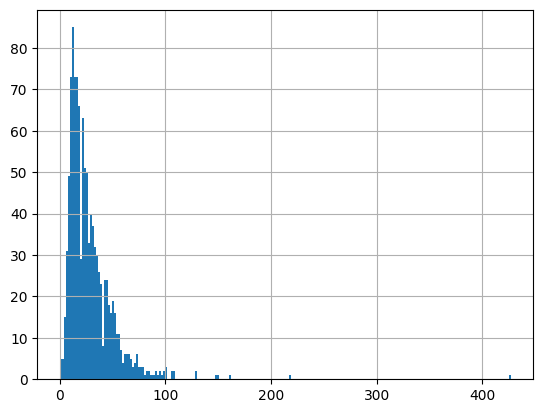

In [50]:
# df_mapa_ips_habitantes['IPS/Habitantes'].hist(bins=50)
# df_mapa_ips_habitantes['IPS/Habitantes'].hist(bins=int(len(df_mapa_ips_habitantes)**(1/2)))
df_mapa_ips_habitantes['IPS/Habitantes'].hist(bins=int(len(df_mapa_ips_habitantes)/5))

In [51]:
df_mapa_ips_habitantes['IPS/Habitantes'].describe()

count    1121.000000
mean       28.516503
std        23.981093
min         0.000000
25%        14.000000
50%        22.000000
75%        37.000000
max       427.000000
Name: IPS/Habitantes, dtype: float64

In [58]:
locations = df_mapa_ips_habitantes['Municipio_Departamento']
fig_mapa = go.Figure(
    go.Choroplethmapbox(
        geojson=geojson,
        locations=locations,
        featureidkey='properties.key',
        z=df_mapa_ips_habitantes['IPS/Habitantes'],
        colorscale=["#d05447", "#A2CDE2", "#A2CDE2", "#3364C7", "#3364C7", "#3364C7", "#3364C7", "#3364C7", "#3364C7", "#3364C7", "#3364C7"],
        colorbar_title="IPS por cada 100 mil habitantes"
        # color
    )
)

fig_mapa.update_layout(
    mapbox_style="white-bg",
    # mapbox_style="carto-positron",
    mapbox_zoom=4.3,
    mapbox_center={"lat": 43.5, "lon": -62.3},
    width=900,
    height=900
)

fig_mapa.show()

<Axes: >

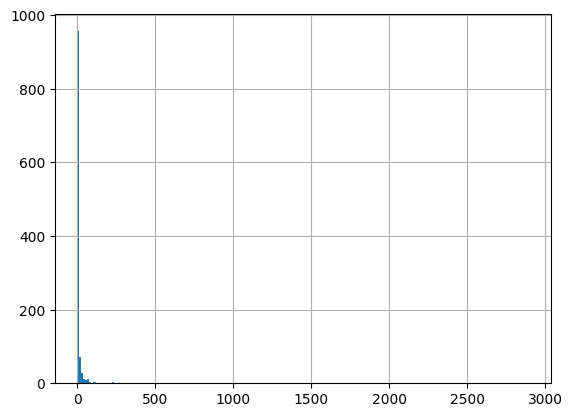

In [106]:
# df_mapa_ips_habitantes['IPS/Habitantes'].hist(bins=50)
# df_mapa_ips_habitantes['IPS/Habitantes'].hist(bins=int(len(df_mapa_ips_habitantes)**(1/2)))
df_mapa_ips_habitantes['IPS_2022'].hist(bins=int(len(df_mapa_ips_habitantes)/5))

In [107]:
df_mapa_ips_habitantes['IPS_2022'].describe()

count    1121.000000
mean       17.596789
std       109.173706
min         0.000000
25%         1.000000
50%         2.000000
75%         7.000000
max      2892.000000
Name: IPS_2022, dtype: float64

In [122]:
a = [1]*5
b = [0, 2]
a, b, b+a

([1, 1, 1, 1, 1], [0, 2], [0, 2, 1, 1, 1, 1, 1])

In [133]:
locations = df_mapa_ips_habitantes['Municipio_Departamento']
fig_mapa = go.Figure(
    go.Choroplethmapbox(
        geojson=geojson,
        locations=locations,
        featureidkey='properties.key',
        z=df_mapa_ips_habitantes['IPS_2022'],
        colorscale=
        # Red
        [
            "#d05447",
        ] 
        +
        # Mid
        [
            "#A2CDE2",            
        ]*3
        +
        # Blue
        [
            "#3364C7",            
        ]*400,
        colorbar_title="IPS por Municipio"
        # color
    )
)

fig_mapa.update_layout(
    mapbox_style="white-bg",
    # mapbox_style="carto-positron",
    mapbox_zoom=4.3,
    mapbox_center={"lat": 43.5, "lon": -62.3},
    width=900,
    height=900
)

fig_mapa.show()